### Import the necessary library

In [ ]:
import numpy as np
import keras as K
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.interpolate import RegularGridInterpolator
from mpl_toolkits.mplot3d import Axes3D
import matplotlib
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.callbacks import ModelCheckpoint
from scipy.ndimage import zoom

#### Data Preprocess for model Development

In [ ]:
train = np.load("/content/drive/MyDrive/output/train_data.npz")
X_train = train['X_train']
y_train = train['Y_train']

In [ ]:
X_train.shape

(2329, 64, 64, 64)

In [ ]:
y_train.shape

(2329, 1)

In [ ]:
def reshape_data(X_data):
    """
    Reshape the dataset from (number of data, 64, 64, 64) to (number of data, 64, 64, 64, 1).

    Parameters:
    X_data: numpy array - Input dataset of shape (number of data, 64, 64, 64)

    Returns:
    X_data_reshaped: numpy array - Reshaped dataset of shape (number of data, 64, 64, 64, 1)
    """
    # Add an extra dimension for the channel (grayscale channel)
    X_data_reshaped = X_data.reshape((-1, 64, 64, 64, 1))
    return X_data_reshaped

# Example usage
# Assuming you have a dataset X_data with shape (number of data, 64, 64, 64)
X_train = reshape_data(X_train)

# You can now print or check the shape of the reshaped data
print(X_train.shape)

(2329, 64, 64, 64, 1)


In [ ]:
test = np.load('/content/drive/MyDrive/output/test_data.npz')
X_test = reshape_data(test['X_test'])
y_test = test['Y_test']
X_test.shape

(583, 64, 64, 64, 1)

In [ ]:
from tensorflow.keras.utils import to_categorical

# Assuming X_train, y_train, X_test, y_test are your training and testing datasets

# Convert labels to one-hot encoding for binary classification
y_train = to_categorical(y_train, num_classes=2)  # Binary classification, 2 classes
y_test = to_categorical(y_test, num_classes=2)

In [ ]:
X_valid= X_test[0:292]
y_valid = y_test[0:292]

### Deep learning model development

Densenet121

In [ ]:
# Define the DenseNet121 3D architecture
def dense_block(x, blocks, name):
    for i in range(blocks):
        x = conv_block(x, 32, name=name + '_block' + str(i + 1))
    return x

def conv_block(x, growth_rate, name):
    x1 = layers.BatchNormalization(axis=4, epsilon=1.001e-5, name=name + '_bn')(x)
    x1 = layers.Activation('relu', name=name + '_relu')(x1)
    x1 = layers.Conv3D(4 * growth_rate, 1, use_bias=False, name=name + '_conv1')(x1)
    x1 = layers.BatchNormalization(axis=4, epsilon=1.001e-5, name=name + '_bn2')(x1)
    x1 = layers.Activation('relu', name=name + '_relu2')(x1)
    x1 = layers.Conv3D(growth_rate, 3, padding='same', use_bias=False, name=name + '_conv2')(x1)
    x = layers.Concatenate(axis=4, name=name + '_concat')([x, x1])
    return x

def transition_block(x, reduction, name):
    x = layers.BatchNormalization(axis=4, epsilon=1.001e-5, name=name + '_bn')(x)
    x = layers.Activation('relu', name=name + '_relu')(x)
    x = layers.Conv3D(int(x.shape[-1] * reduction), 1, use_bias=False, name=name + '_conv')(x)
    x = layers.AvgPool3D(2, strides=2, name=name + '_pool')(x)
    return x

def DenseNet121_3D(input_shape, num_classes):
    inputs = tf.keras.Input(shape=input_shape)

    x = layers.Conv3D(64, 7, strides=2, use_bias=False, padding='same', name='conv1_conv')(inputs)
    x = layers.BatchNormalization(axis=4, epsilon=1.001e-5, name='conv1_bn')(x)
    x = layers.Activation('relu', name='conv1_relu')(x)
    x = layers.MaxPooling3D(3, strides=2, padding='same', name='pool1_pool')(x)

    x = dense_block(x, blocks=6, name='conv2')
    x = transition_block(x, 0.5, name='pool2')

    x = dense_block(x, blocks=12, name='conv3')
    x = transition_block(x, 0.5, name='pool3')

    x = dense_block(x, blocks=24, name='conv4')
    x = transition_block(x, 0.5, name='pool4')

    x = dense_block(x, blocks=16, name='conv5')

    x = layers.BatchNormalization(axis=4, epsilon=1.001e-5, name='bn')(x)
    x = layers.Activation('relu', name='relu')(x)

    x = layers.GlobalAveragePooling3D(name='avg_pool')(x)
    outputs = layers.Dense(num_classes, activation='softmax', name='predictions')(x)

    model = models.Model(inputs, outputs, name='densenet121_3d')

    # Compile the model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Example usage:
input_shape = (64, 64, 64, 1)  # Input shape after reshaping
num_classes = 2  # Adjust based on your number of classes

# Create the 3D DenseNet model
model = DenseNet121_3D(input_shape=input_shape, num_classes=num_classes)

# Print the model summary
model.summary()

Model: "densenet121_3d"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 64, 64, 64, 1)  │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv3D)       │ (None, 32, 32, 32, 64) │         21,952 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 32, 32, 32, 64) │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 32, 32, 32, 64) │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling3D) │ (None, 16, 16, 16, 64) │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_bn           │ (None, 16, 16, 16, 64) │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_relu         │ (None, 16, 16, 16, 64) │              0 │ conv2_block1_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_conv1        │ (None, 16, 16, 16,     │          8,192 │ conv2_block1_relu[0][… │
│ (Conv3D)                  │ 128)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_bn2          │ (None, 16, 16, 16,     │            512 │ conv2_block1_conv1[0]… │
│ (BatchNormalization)      │ 128)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_relu2        │ (None, 16, 16, 16,     │              0 │ conv2_block1_bn2[0][0] │
│ (Activation)              │ 128)                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_conv2        │ (None, 16, 16, 16, 32) │        110,592 │ conv2_block1_relu2[0]… │
│ (Conv3D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_concat       │ (None, 16, 16, 16, 96) │              0 │ pool1_pool[0][0],      │
│ (Concatenate)             │                        │                │ conv2_block1_conv2[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block2_bn           │ (None, 16, 16, 16, 96) │            384 │ conv2_block1_concat[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block2_relu         │ (None, 16, 16, 16, 96) │              0 │ conv2_block2_bn[0][0]  │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block2_conv1   

 Total params: 11,328,322 (43.21 MB)

 Trainable params: 11,244,674 (42.90 MB)

 Non-trainable params: 83,648 (326.75 KB)

In [ ]:
# Checkpoint callback to save the best model
checkpoint = ModelCheckpoint(
    filepath='best_model.keras',    # Path to save the model
    monitor='val_loss',         # Monitor validation accuracy
    verbose=1,                      # Print messages when saving model
    save_best_only=True,            # Save only the best model
    mode='min'                      # Maximize the monitored metric (accuracy)
)

# Train the model
dense_history = model.fit(
    X_train, y_train,                # Training data and labels
    validation_data=(X_valid, y_valid),# Validation data and labels
    epochs=50,                       # Number of epochs
    batch_size=16,                   # Batch size
    callbacks=[checkpoint]           # Save the best model
)

Epoch 1/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 726ms/step - accuracy: 0.8105 - loss: 0.4754
Epoch 1: val_loss improved from inf to 12.81706, saving model to best_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 286s 867ms/step - accuracy: 0.8109 - loss: 0.4745 - val_accuracy: 0.5137 - val_loss: 12.8171
Epoch 2/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - accuracy: 0.9141 - loss: 0.2575
Epoch 2: val_loss improved from 12.81706 to 11.43242, saving model to best_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 11s 78ms/step - accuracy: 0.9141 - loss: 0.2576 - val_accuracy: 0.5137 - val_loss: 11.4324
Epoch 3/50
145/146 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - accuracy: 0.9040 - loss: 0.2915
Epoch 3: val_loss did not improve from 11.43242
146/146 ━━━━━━━━━━━━━━━━━━━━ 9s 63ms/step - accuracy: 0.9040 - loss: 0.2913 - val_accuracy: 0.5137 - val_loss: 17.1417
Epoch 4/50
145/146 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9103 - loss: 0.2757
Epoch 4: val_loss improved from 11.43242 to 3.09086, saving model to best

Resnet Model

In [ ]:
#Resnet model
import tensorflow as tf
from tensorflow.keras import layers, models

def resnet_3d_cnn(input_shape=(64, 64, 64, 1), num_classes=1):
    inputs = tf.keras.Input(shape=input_shape, name="input_1")

    # First Conv3D + MaxPooling3D block
    x = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(inputs)
    x = layers.MaxPooling3D(pool_size=(2, 2, 2))(x)
    x = layers.LayerNormalization()(x)

    # First residual block
    residual_1 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(x)
    residual_1 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(residual_1)
    x = layers.Add()([residual_1, x])
    x = layers.MaxPooling3D(pool_size=(2, 2, 2))(x)
    x = layers.LayerNormalization()(x)

    # Second residual block
    residual_2 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(x)
    residual_2 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(residual_2)
    x = layers.Add()([residual_2, x])
    x = layers.MaxPooling3D(pool_size=(2, 2, 2))(x)
    x = layers.LayerNormalization()(x)

    # Third residual block
    residual_3 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(x)
    residual_3 = layers.Conv3D(64, (3, 3, 3), padding='same', activation='relu')(residual_3)
    x = layers.Add()([residual_3, x])
    x = layers.MaxPooling3D(pool_size=(2, 2, 2))(x)
    x = layers.LayerNormalization()(x)

    # Global average pooling layers for each block
    gap_1 = layers.GlobalAveragePooling3D()(residual_1)
    gap_2 = layers.GlobalAveragePooling3D()(residual_2)
    gap_3 = layers.GlobalAveragePooling3D()(residual_3)

    # Concatenate pooled outputs
    concatenated = layers.Concatenate()([gap_1, gap_2, gap_3])

    # Dense layers
    x = layers.Dense(64, activation='relu')(concatenated)
    x = layers.Dropout(0.5)(x)

    # Output layer for binary classification
    outputs = layers.Dense(2, activation='softmax', name="output")(x)

    # Build the model
    model = models.Model(inputs=inputs, outputs=outputs, name="3D_CNN_Binary")

    return model

# Define input shape and number of output classes
input_shape = (64, 64, 64, 1)

# Create the model
resnet_model = resnet_3d_cnn(input_shape=input_shape, num_classes=1)

# Compile the model for binary classification
resnet_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Print the model summary
resnet_model.summary()


Model: "3D_CNN_Binary"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_1 (InputLayer)      │ (None, 64, 64, 64, 1)  │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d (Conv3D)           │ (None, 64, 64, 64, 64) │          1,792 │ input_1[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d             │ (None, 32, 32, 32, 64) │              0 │ conv3d[0][0]           │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization       │ (None, 32, 32, 32, 64) │            128 │ max_pooling3d[0][0]    │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_1 (Conv3D)         │ (None, 32, 32, 32, 64) │        110,656 │ layer_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_2 (Conv3D)         │ (None, 32, 32, 32, 64) │        110,656 │ conv3d_1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 32, 32, 32, 64) │              0 │ conv3d_2[0][0],        │
│                           │                        │                │ layer_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_1           │ (None, 16, 16, 16, 64) │              0 │ add[0][0]              │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization_1     │ (None, 16, 16, 16, 64) │            128 │ max_pooling3d_1[0][0]  │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_3 (Conv3D)         │ (None, 16, 16, 16, 64) │        110,656 │ layer_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_4 (Conv3D)         │ (None, 16, 16, 16, 64) │        110,656 │ conv3d_3[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_1 (Add)               │ (None, 16, 16, 16, 64) │              0 │ conv3d_4[0][0],        │
│                           │                        │                │ layer_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_2           │ (None, 8, 8, 8, 64)    │              0 │ add_1[0][0]            │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization_2     │ (None, 8, 8, 8, 64)    │            128 │ max_pooling3d_2[0][0]  │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_5 (Conv3D)         │ (None, 8, 8, 8, 64)    │        110,656 │ layer_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_6 (Conv3D)    

 Total params: 678,594 (2.59 MB)

 Trainable params: 678,594 (2.59 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Checkpoint callback to save the best model
checkpoint = ModelCheckpoint(
    filepath='best_resnet_model.keras',    # Path to save the model
    monitor='val_loss',         # Monitor validation accuracy
    verbose=1,                      # Print messages when saving model
    save_best_only=True,            # Save only the best model
    mode='min'                      # Maximize the monitored metric (accuracy)
)

# Train the model
resnet_history = resnet_model.fit(
    X_train, y_train,                # Training data and labels
    validation_data=(X_valid, y_valid),# Validation data and labels
    epochs=50,                       # Number of epochs
    batch_size=16,                   # Batch size
    callbacks=[checkpoint]           # Save the best model
)

Epoch 1/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - accuracy: 0.7865 - loss: 0.4932
Epoch 1: val_loss improved from inf to 0.27118, saving model to best_resnet_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 22s 92ms/step - accuracy: 0.7870 - loss: 0.4924 - val_accuracy: 0.9041 - val_loss: 0.2712
Epoch 2/50
145/146 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.9095 - loss: 0.2834
Epoch 2: val_loss improved from 0.27118 to 0.26122, saving model to best_resnet_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - accuracy: 0.9095 - loss: 0.2832 - val_accuracy: 0.9041 - val_loss: 0.2612
Epoch 3/50
145/146 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.9103 - loss: 0.2872
Epoch 3: val_loss did not improve from 0.26122
146/146 ━━━━━━━━━━━━━━━━━━━━ 6s 37ms/step - accuracy: 0.9104 - loss: 0.2870 - val_accuracy: 0.9041 - val_loss: 0.2698
Epoch 4/50
145/146 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - accuracy: 0.9188 - loss: 0.2553
Epoch 4: val_loss improved from 0.26122 to 0.26038, saving model to be

3D Unet model

In [ ]:
#Unet 3D implementation

def conv_block(input,filter):
  x = layers.Conv3D(filter,(3,3,3),padding='same')(input)
  x = layers.BatchNormalization()(x)
  x = layers.ReLU()(x)
  x = layers.Conv3D(filter,(3,3,3),padding='same')(x)
  x = layers.BatchNormalization()(x)
  x = layers.ReLU()(x)
  return x

def encoder_block(input,filter):
  x = conv_block(input,filter)
  p = layers.MaxPooling3D((2,2,2))(x)
  return x,p

def decoder_block(input,concat_input,filter):
  x = layers.Conv3DTranspose(filter, (2, 2, 2), strides=(2, 2, 2), padding="same")(input)
  x = layers.concatenate([x,concat_input])
  x = conv_block(x, filter)
  return x

def unet3d(input_shape=(64, 64, 64, 1), num_classes=2):
    inputs = layers.Input(input_shape)

    # Encoder
    s1, p1 = encoder_block(inputs, 32)
    s2, p2 = encoder_block(p1, 64)
    s3, p3 = encoder_block(p2, 128)
    s4, p4 = encoder_block(p3, 256)

    # Bottleneck
    b = conv_block(p4, 512)

    # Decoder
    d1 = decoder_block(b, s4, 256)
    d2 = decoder_block(d1, s3, 128)
    d3 = decoder_block(d2, s2, 64)
    d4 = decoder_block(d3, s1, 32)

    # Global Average Pooling for classification
    x = layers.GlobalAveragePooling3D()(d4)

    # Fully connected layers
    x = layers.Dense(128, activation='relu')(x)
    x = layers.Dropout(0.3)(x)
    x = layers.Dense(64, activation='relu')(x)

    # Output layer
    if num_classes == 1:
        output = layers.Dense(1, activation='sigmoid')(x)  # For binary classification
    else:
        output = layers.Dense(num_classes, activation='softmax')(x)  # For multi-class classification

    model = models.Model(inputs, output)

    model.compile(optimizer='adam',
                  loss='binary_crossentropy' if num_classes == 1 else 'categorical_crossentropy',
                  metrics=['accuracy'])

    return model

# Build and summarize the model
input_shape = (64, 64, 64, 1)  # Shape of your 3D MRI data
num_classes = 2  # Binary classification (stroke vs. no stroke)
unet_model = unet3d(input_shape, num_classes)
unet_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 64, 64, 64, 1)  │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_7 (Conv3D)         │ (None, 64, 64, 64, 32) │            896 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 64, 64, 64, 32) │            128 │ conv3d_7[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu (ReLU)              │ (None, 64, 64, 64, 32) │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_8 (Conv3D)         │ (None, 64, 64, 64, 32) │         27,680 │ re_lu[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_1     │ (None, 64, 64, 64, 32) │            128 │ conv3d_8[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_1 (ReLU)            │ (None, 64, 64, 64, 32) │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_4           │ (None, 32, 32, 32, 32) │              0 │ re_lu_1[0][0]          │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_9 (Conv3D)         │ (None, 32, 32, 32, 64) │         55,360 │ max_pooling3d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 32, 32, 32, 64) │            256 │ conv3d_9[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_2 (ReLU)            │ (None, 32, 32, 32, 64) │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_10 (Conv3D)        │ (None, 32, 32, 32, 64) │        110,656 │ re_lu_2[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_3     │ (None, 32, 32, 32, 64) │            256 │ conv3d_10[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_3 (ReLU)            │ (None, 32, 32, 32, 64) │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling3d_5           │ (None, 16, 16, 16, 64) │              0 │ re_lu_3[0][0]          │
│ (MaxPooling3D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv3d_11 (Conv3D)        │ (None, 16, 16, 16,     │        221,312 │ max_pooling3d_5[0][0]  │
│                      

 Total params: 22,599,682 (86.21 MB)

 Trainable params: 22,593,794 (86.19 MB)

 Non-trainable params: 5,888 (23.00 KB)

In [ ]:
# Checkpoint callback to save the best model
checkpoint = ModelCheckpoint(
    filepath='best_unet_model.keras',    # Path to save the model
    monitor='val_loss',         # Monitor validation accuracy
    verbose=1,                      # Print messages when saving model
    save_best_only=True,            # Save only the best model
    mode='min'                      # Maximize the monitored metric (accuracy)
)

# Train the model
unet_history = unet_model.fit(
    X_train, y_train,                # Training data and labels
    validation_data=(X_valid, y_valid),# Validation data and labels
    epochs=50,                       # Number of epochs
    batch_size=16,                   # Batch size
    callbacks=[checkpoint]           # Save the best model
)

Epoch 1/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 293ms/step - accuracy: 0.8699 - loss: 0.3476
Epoch 1: val_loss improved from inf to 648.01239, saving model to best_unet_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 88s 355ms/step - accuracy: 0.8701 - loss: 0.3472 - val_accuracy: 0.5137 - val_loss: 648.0124
Epoch 2/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - accuracy: 0.9244 - loss: 0.2326
Epoch 2: val_loss improved from 648.01239 to 2.04342, saving model to best_unet_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 26s 176ms/step - accuracy: 0.9244 - loss: 0.2328 - val_accuracy: 0.5137 - val_loss: 2.0434
Epoch 3/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - accuracy: 0.9005 - loss: 0.2780
Epoch 3: val_loss improved from 2.04342 to 1.95017, saving model to best_unet_model.keras
146/146 ━━━━━━━━━━━━━━━━━━━━ 26s 176ms/step - accuracy: 0.9006 - loss: 0.2779 - val_accuracy: 0.4829 - val_loss: 1.9502
Epoch 4/50
146/146 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step - accuracy: 0.9021 - loss: 0.2783
Epoch 4: val_los

#### Comparing the result of each model (Accuracy and Loss)

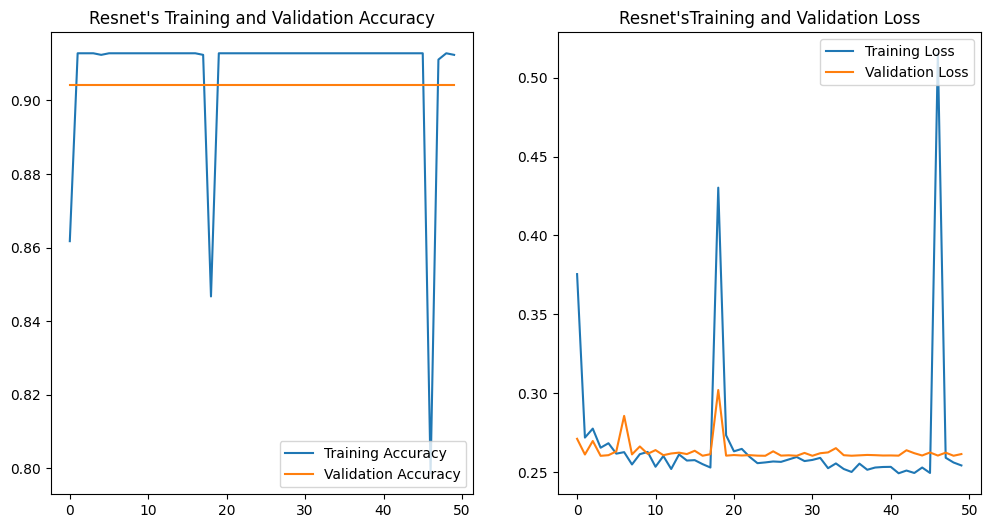

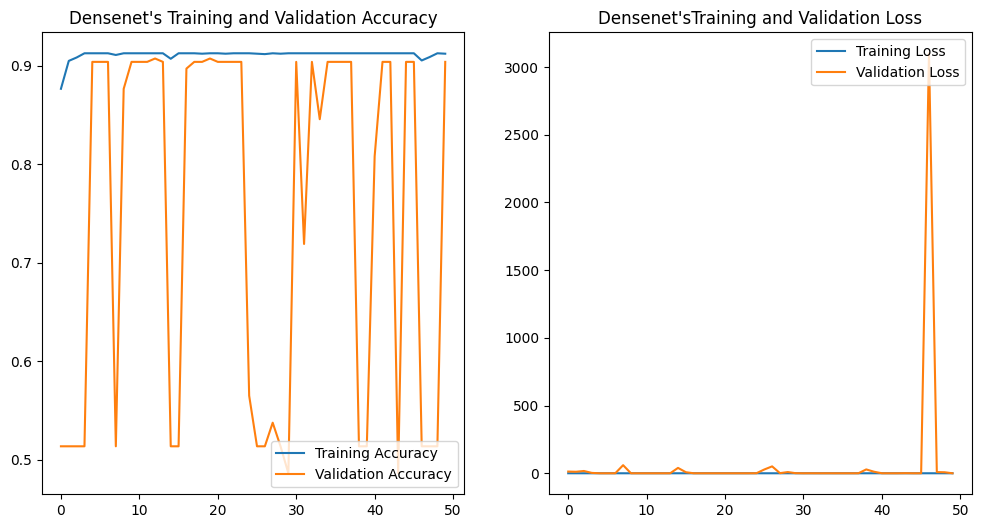

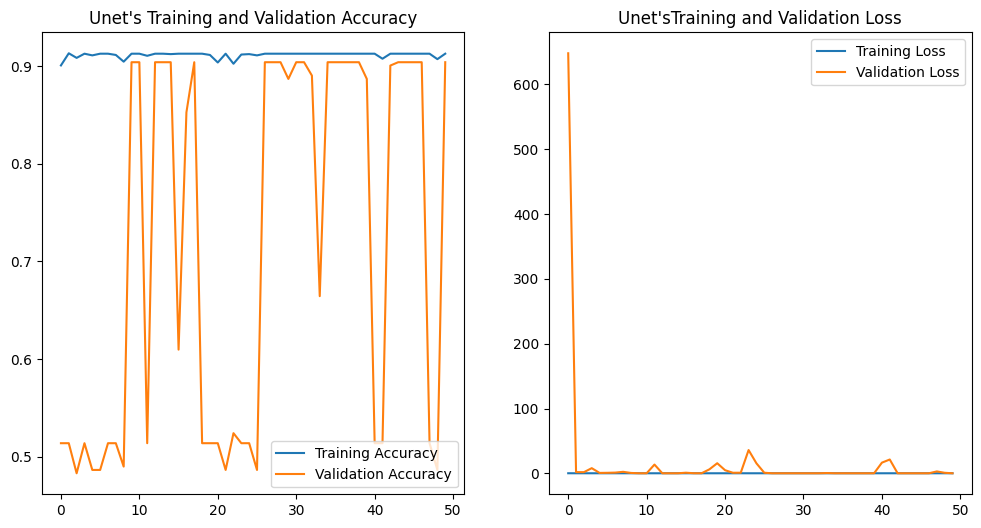

In [ ]:
def plot_history(history,model_name):
    # Retrieve values from the history object
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs_range = range(len(acc))

    # Plotting accuracy
    plt.figure(figsize=(12, 6))

    # Accuracy subplot
    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, acc, label='Training Accuracy')
    plt.plot(epochs_range, val_acc, label='Validation Accuracy')
    plt.legend(loc='lower right')
    plt.title(f"{model_name}'s Training and Validation Accuracy")

    # Loss subplot
    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, loss, label='Training Loss')
    plt.plot(epochs_range, val_loss, label='Validation Loss')
    plt.legend(loc='upper right')
    plt.title(f"{model_name}'sTraining and Validation Loss")

    # Show the plot
    plt.show()

# Call the plot function
plot_history(resnet_history,"Resnet")
plot_history(dense_history,"Densenet")
plot_history(unet_history,"Unet")

#### Classification Report

In [ ]:
from sklearn.metrics import classification_report,roc_auc_score,accuracy_score

def classification_report_model(model_file_path):
  model = tf.keras.models.load_model(model_file_path)

  # Make predictions
  y_pred_probs = model.predict(X_test)

  # Convert predicted probabilities to class labels
  # For binary classification, you can threshold at 0.5
  y_pred = (y_pred_probs > 0.5).astype(int)

  # Generate classification report
  report = classification_report(y_test, y_pred, target_names=['Class 0', 'Class 1'])
  # Assuming you already have y_true and y_pred from your model's predictions
  accuracy = accuracy_score(y_test, y_pred)
  auc_score_model = roc_auc_score(y_test, y_pred_probs)

  # Print the report
  print(report)
  print(f"Accuracy: {accuracy:.2f}")
  print(f"Model AUC: {auc_score_model:.2f}")

In [ ]:
classification_report_model('/content/best_densenet_model.keras')

19/19 ━━━━━━━━━━━━━━━━━━━━ 1048s 55s/step
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90       309
     Class 1       0.83      1.00      0.91       274

   micro avg       0.90      0.90      0.90       583
   macro avg       0.92      0.91      0.90       583
weighted avg       0.92      0.90      0.90       583
 samples avg       0.90      0.90      0.90       583

Accuracy: 0.90
Model AUC: 0.92


In [ ]:
classification_report_model('/content/best_resnet_model.keras')

19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90       309
     Class 1       0.83      1.00      0.91       274

   micro avg       0.90      0.90      0.90       583
   macro avg       0.92      0.91      0.90       583
weighted avg       0.92      0.90      0.90       583
 samples avg       0.90      0.90      0.90       583

Accuracy: 0.90
Model AUC: 0.92


In [ ]:
classification_report_model('/content/best_unet_model.keras')

19/19 ━━━━━━━━━━━━━━━━━━━━ 4s 164ms/step
              precision    recall  f1-score   support

     Class 0       1.00      0.82      0.90       309
     Class 1       0.83      1.00      0.91       274

   micro avg       0.90      0.90      0.90       583
   macro avg       0.92      0.91      0.90       583
weighted avg       0.92      0.90      0.90       583
 samples avg       0.90      0.90      0.90       583

Accuracy: 0.90
Model AUC: 0.92


##Explainable Deep Learning

In [ ]:
# Preparing model and data for
image = X_test[0:1]  # Use a single image
densenet_model = tf.keras.models.load_model("/content/best_densenet_model.keras")
resnet_model = tf.keras.models.load_model("/content/best_resnet_model.keras")
unet_model = tf.keras.models.load_model("/content/best_unet_model.keras")

###Occlusion Sensitivity

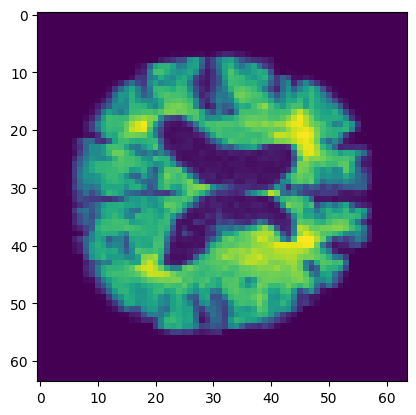

In [ ]:
plt.imshow(X_test[0][:,:,32])

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━

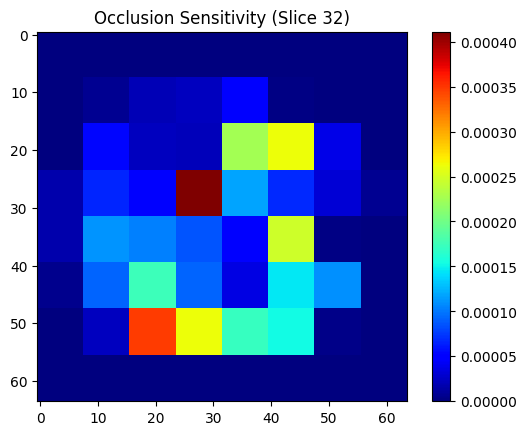

In [ ]:
import numpy as np
import tensorflow as tf

# Example function for occlusion sensitivity
def occlusion_sensitivity(model, data, label, patch_size=(8, 8, 8)):
    """
    Perform occlusion sensitivity by occluding different parts of the 3D image and measuring the effect
    on the model's prediction confidence.

    :param model: Trained 3D CNN model.
    :param data: Input 3D MRI scan (shape should be e.g., (64, 64, 64, 1)).
    :param label: The true class label or class index for which we want to measure sensitivity.
    :param patch_size: The size of the 3D block to occlude in the MRI.
    :return: sensitivity_map, showing the importance of different regions in the MRI scan.
    """
    # Original prediction probability for the true label
    original_pred = model.predict(np.expand_dims(data, axis=0))[0, label]

    # Initialize sensitivity map with zeros (same shape as the MRI scan)
    sensitivity_map = np.zeros(data.shape[:-1])  # Exclude channel dimension

    # Slide over the MRI volume and occlude patches
    for i in range(0, data.shape[0] - patch_size[0] + 1, patch_size[0]):
        for j in range(0, data.shape[1] - patch_size[1] + 1, patch_size[1]):
            for k in range(0, data.shape[2] - patch_size[2] + 1, patch_size[2]):
                # Make a copy of the data to occlude a patch
                data_occluded = np.copy(data)
                # Occlude a block of voxels by replacing them with zeros
                data_occluded[i:i+patch_size[0], j:j+patch_size[1], k:k+patch_size[2], :] = 0

                # Predict with the occluded data
                occluded_pred = model.predict(np.expand_dims(data_occluded, axis=0))[0, label]

                # Compute sensitivity as the change in prediction confidence
                sensitivity = abs(original_pred - occluded_pred)

                # Store sensitivity score in the sensitivity map
                sensitivity_map[i:i+patch_size[0], j:j+patch_size[1], k:k+patch_size[2]] = sensitivity

    return sensitivity_map


# Perform occlusion sensitivity
sensitivity_map = occlusion_sensitivity(densenet_model, X_test[0], y_test[0], patch_size=(8, 8, 8))

# Plot one of the 2D slices of the sensitivity map for visualization
plt.imshow(sensitivity_map[:, :, 32], cmap='jet')  # Example: show the 32nd slice
plt.colorbar()
plt.title('Occlusion Sensitivity (Slice 32)')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━

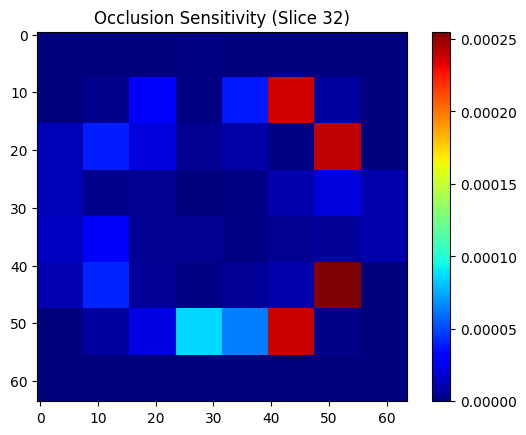

In [ ]:
# Perform occlusion sensitivity
sensitivity_map = occlusion_sensitivity(resnet_model, X_test[0], y_test[0], patch_size=(8, 8, 8))

# Plot one of the 2D slices of the sensitivity map for visualization
plt.imshow(sensitivity_map[:, :, 32], cmap='jet')  # Example: show the 32nd slice
plt.colorbar()
plt.title('Occlusion Sensitivity (Slice 32)')
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━

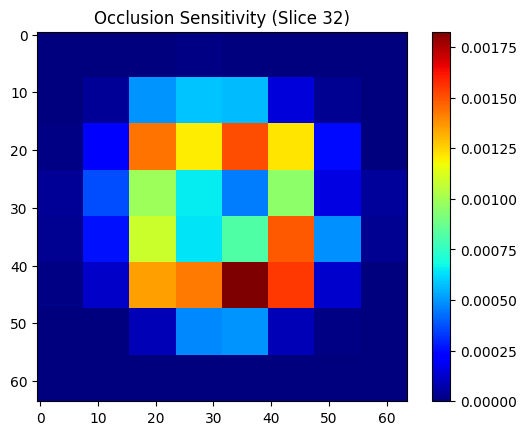

In [ ]:
# Perform occlusion sensitivity
sensitivity_map = occlusion_sensitivity(unet_model, X_test[0], y_test[0], patch_size=(8, 8, 8))

# Plot one of the 2D slices of the sensitivity map for visualization
plt.imshow(sensitivity_map[:, :, 32], cmap='jet')  # Example: show the 32nd slice
plt.colorbar()
plt.title('Occlusion Sensitivity (Slice 32)')
plt.show()

###LIME(Local Interpretable Model-Agnostic Explanations)

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 6.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=68beb52bf587809245f25dde352e5c417909276ff56dd0fb58ef1aa89006fe50
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime import lime_image
from skimage.segmentation import mark_boundaries

# Define the LIME explanation function with a model argument
def lime_explanation(model, X_test, slice_idx=32, label=1, num_samples=1000):
    """
    Generates a LIME explanation for a specific 2D slice from a 3D MRI scan using a specified model.

    :param model: Trained model to use for prediction.
    :param X_test: 3D MRI scan data (num_samples, 64, 64, 64, 1).
    :param slice_idx: Index of the 2D slice from the 3D volume to analyze (default=32).
    :param label: The class label to explain (default=1 for stroke class).
    :param num_samples: Number of perturbed samples to generate for LIME (default=1000).
    """
    # Extract the 2D slice from the 3D MRI
    X_test_slice = X_test[0, :, :, slice_idx, 0]  # Extract the specified 2D slice

    # Function for making predictions on the extracted slice
    def model_predict_for_lime(input_data):
        # LIME passes multiple perturbed samples at once
        n_samples = input_data.shape[0]

        # Initialize an empty array to hold the predictions
        predictions = np.zeros((n_samples, model.output_shape[-1]))

        for i in range(n_samples):
            # Convert the perturbed 2D slice to grayscale (average the 3 RGB channels)
            grayscale_slice = np.mean(input_data[i], axis=-1)

            # Reshape the 2D slice back to 3D format expected by the model (batch_size, 64, 64, 64, 1)
            reshaped_input = np.zeros((1, 64, 64, 64, 1))  # Create an empty 3D volume
            reshaped_input[0, :, :, slice_idx, 0] = grayscale_slice  # Insert the perturbed slice

            # Get prediction from the model for the reshaped input
            predictions[i] = model.predict(reshaped_input)

        return predictions

    # Initialize the LIME image explainer
    explainer = lime_image.LimeImageExplainer()

    # Generate the LIME explanation for the 2D MRI slice
    explanation = explainer.explain_instance(
        X_test_slice,  # The 2D MRI slice
        model_predict_for_lime,  # The model prediction function
        top_labels=2,  # Number of top classes to explain
        hide_color=0,  # Color for occluded regions (black)
        num_samples=num_samples  # Number of perturbed samples to generate
    )

    # Get the explanation for the specified class (e.g., stroke class = 1)
    temp, mask = explanation.get_image_and_mask(label=label, positive_only=False, hide_rest=False)

    # Visualize the original MRI slice and the LIME explanation
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))

    # Show the original 2D MRI slice
    ax[0].imshow(X_test_slice, cmap='gray')
    ax[0].set_title(f'Original MRI Slice (Slice {slice_idx})')

    # Show the LIME explanation with boundaries overlaid
    ax[1].imshow(mark_boundaries(temp, mask))
    ax[1].set_title('LIME Explanation')

    plt.show()

LIME Explanation for Densenet:


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━

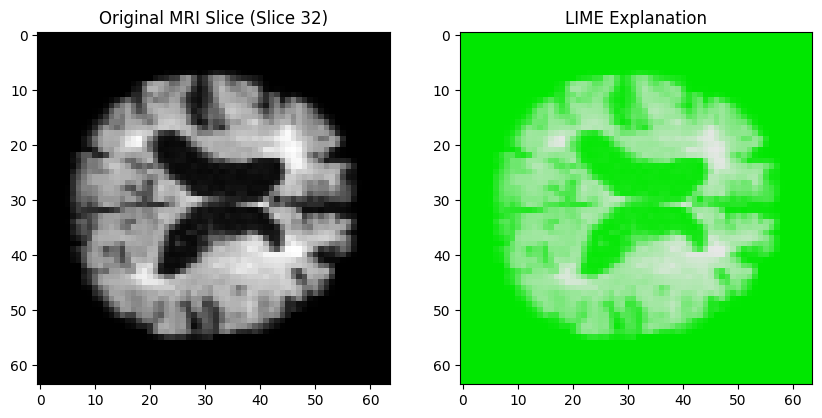

In [ ]:
# Call the function for model1
print("LIME Explanation for Densenet:")
lime_explanation(model=densenet_model, X_test=X_test, slice_idx=32, label=1, num_samples=1000)

LIME Explanation for Resnet:


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 874ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━

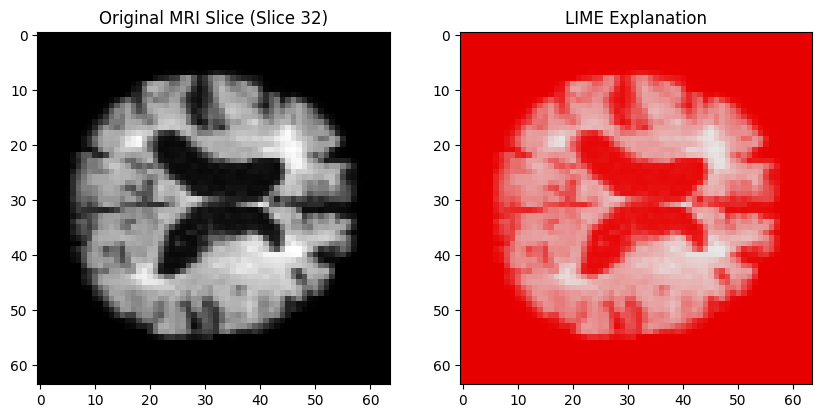

In [ ]:
# Call the function for model2
print("LIME Explanation for Resnet:")
lime_explanation(model=resnet_model, X_test=X_test, slice_idx=32, label=1, num_samples=1000)

LIME Explanation for Unet:


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━

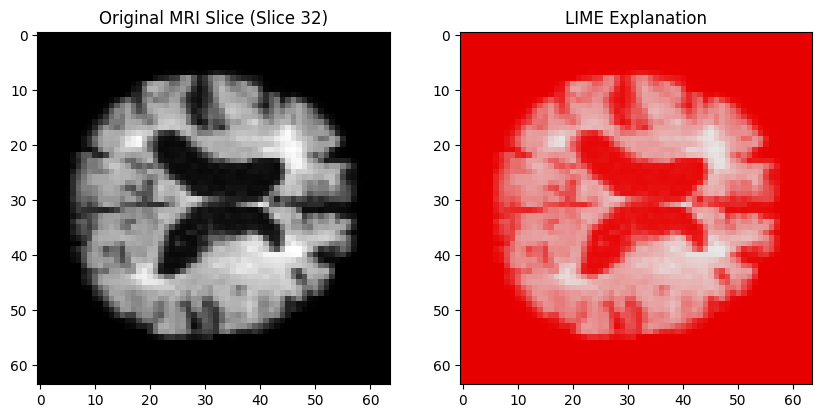

In [ ]:
# Call the function for model3
print("LIME Explanation for Unet:")
lime_explanation(model=unet_model, X_test=X_test, slice_idx=32, label=1, num_samples=1000)

### GradCam

In [ ]:
def grad_cam(model, img, last_conv_layer):
    # Remove the last layer's softmax
    model.layers[-1].activation = None

    grad_model = tf.keras.models.Model(
        [model.inputs],
        [model.get_layer(last_conv_layer).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img)

        # Convert predictions to tensor if needed
        predictions = tf.convert_to_tensor(predictions)

        class_idx = tf.argmax(predictions[0])
        # Use tf.gather to safely index predictions
        loss = tf.gather(predictions, class_idx, axis=1)

    # Compute the gradient of the top predicted class for the output feature map
    grads = tape.gradient(loss, conv_outputs)[0]

    # Compute the channel-wise mean of the gradient guided activations
    output = conv_outputs[0]
    grads = tf.reduce_mean(grads, axis=(0,1,2))

    # Weighted combination of forward activation maps and gradients
    cam = np.zeros(output.shape[:3], dtype=np.float32)
    for i in range(output.shape[-1]):
        cam += grads[i] * output[:, :, :, i]

    cam = np.maximum(cam, 0)  # ReLU
    cam = cam / np.max(cam)  # Normalize

    return cam

In [ ]:
gradcam = grad_cam(densenet_model,image,'conv5_block16_conv2')
gradcam_res = grad_cam(resnet_model,image,'conv3d_6')
gradcam_unet = grad_cam(unet_model,image,'conv3d_24')
gradcam.shape

(2, 2, 2)

In [ ]:
def upsample_gradcam(gradcam, scale_factor=2):
    size = gradcam.shape[0]
    pts = np.array([[x, y, z] for x in np.linspace(0, size - 1, size * scale_factor)
                               for y in np.linspace(0, size - 1, size * scale_factor)
                               for z in np.linspace(0, size - 1, size * scale_factor)])
    interpolator = RegularGridInterpolator((np.arange(size), np.arange(size), np.arange(size)), gradcam)
    upsampled_gradcam = interpolator(pts).reshape((size * scale_factor, size * scale_factor, size * scale_factor))
    return upsampled_gradcam

def resize_heatmap(heatmap, target_shape=(64, 64, 64)):
    zoom_factors = [t / h for t, h in zip(target_shape, heatmap.shape)]
    return zoom(heatmap, zoom_factors, order=1)  # 'order=1' means bilinear interpolation

In [ ]:
#Dense Gradcam
upsampled_gradcam_dense = upsample_gradcam(gradcam)
upsampled_gradcam_dense = resize_heatmap(upsampled_gradcam_dense,target_shape=(64, 64, 64))

#Resnet Gradcam
upsampled_gradcam_resnet = upsample_gradcam(gradcam_res)
upsampled_gradcam_resnet = resize_heatmap(upsampled_gradcam_resnet,target_shape=(64, 64, 64))

#Unet Gradcam
upsampled_gradcam_unet = upsample_gradcam(gradcam_unet)
upsampled_gradcam_unet = resize_heatmap(upsampled_gradcam_unet,target_shape=(64, 64, 64))

In [ ]:
def display_gradcam_3d(img, heatmap, alpha=0.4):
    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = matplotlib.colormaps["cool"]

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    superimposed_img = jet_heatmap * alpha + img

    return superimposed_img

gradcam_resize_dense = display_gradcam_3d(image, upsampled_gradcam_dense,alpha = 1)
gradcam_resize_resnet = display_gradcam_3d(image, upsampled_gradcam_resnet,alpha = 1)
gradcam_resize_unet = display_gradcam_3d(image, upsampled_gradcam_unet,alpha = 1)

In [ ]:
def plot3d(volume):
    fig = go.Figure(data=go.Volume(
        x=np.arange(volume.shape[0]).repeat(volume.shape[1]*volume.shape[2]),
        y=np.tile(np.arange(volume.shape[1]).repeat(volume.shape[2]), volume.shape[0]),
        z=np.tile(np.arange(volume.shape[2]), volume.shape[0]*volume.shape[1]),
        value=volume.flatten(),
        opacity=0.1, # needs to be small to see through all surfaces
        surface_count=20, # needs to be a large number for good volume rendering
        colorscale='RdYlBu',  # Replace with an RGB-like colormap
    ))
    fig.show()

In [ ]:
plot3d(X_test[0,:,:,:,0])

In [ ]:
plot3d(gradcam_resize_dense[0,:,:,:,0])

In [ ]:
plot3d(gradcam_resize_resnet[0,:,:,:,0])

In [ ]:
plot3d(gradcam_resize_unet[0,:,:,:,0])